# LodeSTAR
LodeSTAR stands for Localization and detection from Symmetries, Translations And Rotations.
Deep-learning method for object detection in microscopy:
 - Self-supervised: no labeled data is needed
 - Single-shot: Can be trained from a single unlabeled experimental image.
 - Equivariant to roto-translational symmetries: the input transformation affects on the output transformation accordingly.


In [2]:
import sys
print(sys.executable)
!pip list | grep deeptrack
!pip list | grep deeplay

/opt/python-envs/myenv/bin/python
deeptrack                 2.0.1
deeplay                   0.1.3


In [1]:
import deeptrack as dt
import deeptrack.deeplay as dl 
import numpy as np
import matplotlib.pyplot as plt
import os
import sys
import torch
from deeptrack.deeplay import LodeSTAR

/opt/python-envs/myenv/lib/python3.12/site-packages/deeptrack/__init__.py:14: UserWarning: TensorFlow is detected in your environment. DeepTrack2 version 2.0++ no longer supports TensorFlow. If you need TensorFlow support, please install the legacy version 1.7 of DeepTrack2:

    pip install deeptrack==1.7

For more details, refer to the DeepTrack documentation.
  warnings.warn(


### Janus samples from YOLOTrack-1.1

In [ ]:
image_dir = "/home/edgar/Desktop/mydocs/SHK/MONA/Yolo/YOLOTrack-1.1/Samples"
data_list = []
for file in os.listdir(image_dir):
    if file.endswith(".jpg"):
        data = dt.LoadImage(os.path.join(image_dir, file))
        # Try resolving if it's a DeepTrack node
        if hasattr(data, "resolve"):
            data = data.resolve()
        # Convert to numpy array and ensure numeric dtype
        data = np.array(data)
        if data.dtype == object:
            data = data.astype(np.float32)
        #print(data.shape, data.dtype)
        plt.imshow(data, cmap="gray")
        plt.axis("off")
        plt.show()
        data_list.append(data)

- Crop image is needed.

For now, separate script has been used to manually crop a particle from the sample images.

In LodeSTAR tutorial, the utilized dataset contained the labels for each particle, which have been passed to the regionprops to automatically crop the image.
One can use the annotations from "YOLOTrack 1.1 Training (Python)/Dataset/train_annotations" as a label. #TBD

In [ ]:
image_dir = "/home/edgar/Desktop/mydocs/SHK/MONA/cropped_objects"
cropped_images = []
for file in os.listdir(image_dir):
    if file.endswith(".jpg"):
        cropped_image = dt.LoadImage(os.path.join(image_dir, file))
        # Try resolving if it's a DeepTrack node
        if hasattr(cropped_image, "resolve"):
            cropped_image = cropped_image.resolve()
        # Convert to numpy array and ensure numeric dtype
        cropped_image = np.array(cropped_image)
        if cropped_image.dtype == object:
            cropped_image = cropped_image.astype(np.float32)
        #print(cropped_image.shape, cropped_image.dtype)
        plt.imshow(cropped_image, cmap="gray")
        plt.axis("off")
        plt.show()
        cropped_images.append(cropped_image)

The last crop image has been selected.

In [ ]:
crop = cropped_images[0]

plt.imshow(crop, cmap="gray")
plt.axis("off")
plt.show()

The following training pipeline is applied.

$ I' = \alpha I + \beta $,

where $\alpha \in [0.9:1.1]$ and $ \beta \in [-0.1:0.1] $ are random numbers.

Number of unique samples ($I'$) are 400.

In [5]:
training_pipeline = (
    dt.Value(crop)
    >> dt.Multiply(lambda: np.random.uniform(0.9, 1.1))
    >> dt.Add(lambda: np.random.uniform(-0.1, 0.1))
    >> dt.MoveAxis(-1, 0)
    >> dt.pytorch.ToTensor(dtype=torch.float32)
)

training_dataset = dt.pytorch.Dataset(training_pipeline, length=400, 
                                      replace=False)

Batch size is 8.

For each input, the model applies 4 different random transformations.


In [8]:
dataloader = dl.DataLoader(training_dataset, batch_size=8, shuffle=True, num_workers=15)

lodestar = dl.LodeSTAR(n_transforms=4, optimizer=dl.Adam(lr=1e-4)).build()
trainer = dl.Trainer(max_epochs=50)

### Training

**Equivariance**: A function(NN) $f$ is said to be equivariant to a transformation if
$$f(T(I)) = T'(f(I)),$$
where $T$ is the transformation map(roto-translation), and T' is the transformation map of the prediction of the original image to the prediction of the transformed image. 

![](maps.png)

For a single cropped image $k$ numbers of Transformations $T$ are produced(Augmentation). These $k$ images are supplied to the CNN for training. Optmizer carries out the tuning of the parameters($w_{i,j}$ & $b_{i,j}$) to reach the convergence of $\{C_k\}$. 

![](./single_shot%20diagram.png)

The output of the CNN is 3 channel tensor ($3 \times N/2 \times M/2 $):
- Vector field tensor $V$ ($2 \times N/2 \times M/2 $) - At each location (i,j), the vector points from that pixel to the object center. 
    - The vector at each pixel is relative to the pixel’s own position.
    To get the predicted object position from each pixel, the vector is added to the pixel’s coordinates:
    $$p_{i,j} = (i,j) + V_{i,j}$$
- Weight Map Tensor - how much each pixel’s vector should contribute to the final prediction. ($\Sigma_{i,j} \rho_{i,j} = 1$)

Train the model and save.

In [ ]:
trainer.fit(lodestar, dataloader)
torch.save(lodestar.state_dict(), "lodestar_weights.pth")

### Predictions

Load the saved model.

In [ ]:
lodestar = LodeSTAR(n_transforms=4, optimizer=dl.Adam(lr=1e-4)).build()
lodestar.load_state_dict(torch.load('lodestar_weights.pth'))
lodestar.eval()

In [ ]:
img_pred_list = []
for idx in range(len(data_list)):
    torch_image = torch.from_numpy(data_list[idx]).permute(2, 0, 1).unsqueeze(0).float()
    prediction = lodestar(torch_image)[0].detach().numpy()
    x, y, rho = prediction[0], prediction[1], prediction[-1]
    img_pred_list.append((x, y, rho))

    plt.figure(figsize=(15, 10))

    plt.subplot(1, 3, 1)
    plt.imshow(data_list[idx], cmap="gray")
    plt.axis("off")

    plt.subplot(1, 3, 2)
    plt.imshow(rho, cmap="gray")
    plt.axis("off")

    plt.subplot(1, 3, 3)
    plt.imshow(data_list[idx], cmap="gray")
    plt.scatter(y.flatten(), x.flatten(), alpha=rho.flatten() / rho.max(), s=5)
    plt.axis("off") 

    plt.show()

### Detection 

$\text{score} = \rho^\alpha \cdot \text{consistency}^\beta$
Finds peaks in the score map above threshold using scipy.morphology.h_maxima()

In [6]:
alpha = 0.2 # metric of object similarity: higher alpha higher object difference
beta = 1 - alpha
cutoff = 0.2 # detection threshold 
mode = "constant" # threshold calculation method. constant: number of object vary significantly image to image, quantile: if number of objects relatively constant.

In [ ]:
for idx in range(len(data_list)):
    torch_image = torch.from_numpy(data_list[idx]).permute(2, 0, 1).unsqueeze(0).float()
    detections = lodestar.detect(torch_image, alpha=alpha, beta=beta, 
                                 mode="constant", cutoff=cutoff)[0]

    plt.figure()
    plt.imshow(data_list[idx], cmap="gray")
    plt.scatter(detections[:, 1], detections[:, 0], s=5, color="red")
    plt.axis("off")

    plt.show()

In [ ]:
idx = 2
torch_image = torch.from_numpy(data_list[idx]).permute(2, 0, 1).unsqueeze(0).float()
prediction = lodestar(torch_image)[0].detach().numpy()
x, y, rho = prediction[0], prediction[1], prediction[-1]
plt.figure(figsize=(15, 5))
plt.subplot(1, 3, 1)
plt.title("x channel")
plt.imshow(x*rho, cmap="jet")
plt.axis("off")

plt.subplot(1, 3, 2)
plt.title("y channel")
plt.imshow(y*rho, cmap="jet")
plt.axis("off")

plt.subplot(1, 3, 3)
plt.title("rho (heatmap)")
plt.imshow(rho, cmap="jet")
plt.axis("off")

plt.show()

### More data

In [2]:
import xml.etree.ElementTree as ET
from sklearn.metrics import f1_score, precision_score, recall_score

# --- XML Parsing Function ---
def parse_xml_annotations(xml_file_path):

    """
    Parses an XML annotation file and extracts bounding box information.

    Args:
        xml_file_path (str): The path to the XML annotation file.

    Returns:
        list: A list of dictionaries, where each dictionary represents a bounding box
              with keys 'xmin', 'ymin', 'xmax', 'ymax'.
    """
    tree = ET.parse(xml_file_path)
    root = tree.getroot()
    bounding_boxes = []
    for obj in root.findall('object'):
        bndbox = obj.find('bndbox')
        xmin = float(bndbox.find('xmin').text)
        ymin = float(bndbox.find('ymin').text)
        xmax = float(bndbox.find('xmax').text)
        ymax = float(bndbox.find('ymax').text)
        bounding_boxes.append({'xmin': xmin, 'ymin': ymin, 'xmax': xmax, 'ymax': ymax})
    return bounding_boxes

In [ ]:
image_dir = "/home/edgar/Desktop/mydocs/SHK/MONA/Yolo/YOLOTrack-1.1/YOLOTrack 1.1 Training (Python)/Dataset/"
data_list = []
annotations = []
all_ground_truth_bboxes = []


for dir_name in os.listdir(image_dir):
    subdir_path = os.path.join(image_dir, dir_name)
    if os.path.isdir(subdir_path):
        # Check if it's an image directory (e.g., 'test_images', 'train_images', 'valid_images')
        if dir_name.endswith("_images"):
            annotation_dir_name = dir_name.replace("_images", "_annotations")
            annotation_subdir_path = os.path.join(image_dir, annotation_dir_name)

            if not os.path.exists(annotation_subdir_path):
                print(f"Warning: Corresponding annotation directory '{annotation_subdir_path}' not found for '{subdir_path}'. Skipping.")
                continue

            print(f"Processing images in: {subdir_path}")
            for file_name in os.listdir(subdir_path):
                if file_name.endswith(".jpg"):
                    image_path = os.path.join(subdir_path, file_name)
                    data = dt.LoadImage(image_path)
                # Try resolving if it's a DeepTrack node
                if hasattr(data, "resolve"):
                    data = data.resolve()
                # Convert to numpy array and ensure numeric dtype
                data = np.array(data)
                if data.dtype == object:
                    data = data.astype(np.float32)
                data_list.append(data)
                xml_file_name = file_name.replace(".jpg", ".xml")
                xml_file_path = os.path.join(annotation_subdir_path, xml_file_name)
                
                ground_truth_bboxes = parse_xml_annotations(xml_file_path)
                all_ground_truth_bboxes.append(ground_truth_bboxes)

In [ ]:
img_pred_list = []
for idx in range(len(data_list)):
    torch_image = torch.from_numpy(data_list[idx]).permute(2, 0, 1).unsqueeze(0).float()
    prediction = lodestar(torch_image)[0].detach().numpy()
    x, y, rho = prediction[0], prediction[1], prediction[-1]
    img_pred_list.append((x, y, rho))

    plt.figure(figsize=(15, 10))

    plt.subplot(1, 3, 1)
    plt.imshow(data_list[idx], cmap="gray")
    plt.axis("off")

    plt.subplot(1, 3, 2)
    plt.imshow(rho, cmap="gray")
    plt.axis("off")

    plt.subplot(1, 3, 3)
    plt.imshow(data_list[idx], cmap="gray")
    plt.scatter(y.flatten(), x.flatten(), alpha=rho.flatten() / rho.max(), s=5)
    plt.axis("off") 

    plt.show()

In [75]:
# --- Point in Bounding Box Check Function ---
def is_point_in_bbox(point_x, point_y, bbox):
    """
    Checks if a given point (x, y) is inside a bounding box.

    Args:
        point_x (float): The x-coordinate of the point.
        point_y (float): The y-coordinate of the point.
        bbox (dict): A dictionary representing the bounding box with 'xmin', 'ymin', 'xmax', 'ymax'.

    Returns:
        bool: True if the point is inside the bounding box, False otherwise.
    """
    return bbox['xmin'] <= point_x <= bbox['xmax'] and \
           bbox['ymin'] <= point_y <= bbox['ymax']

# --- F1 Score Calculation Function ---
def calculate_f1_score(ground_truth_bboxes, detected_points):
    """
    Calculates the F1 score based on whether detected points fall within ground truth bounding boxes.

    Args:
        ground_truth_bboxes (list): A list of dictionaries, each representing a ground truth
                                    bounding box.
        detected_points (torch.Tensor): A tensor of detected points, where each row is [y, x].

    Returns:
        tuple: A tuple containing (f1, precision, recall).
    """
    num_ground_truth = len(ground_truth_bboxes)
    num_detections = detected_points.shape[0]

    # Initialize lists to store true labels and predicted labels for F1 calculation
    # For each ground truth bounding box, we want to know if it was "detected"
    # For each detected point, we want to know if it was a "true detection"
    
    # We'll create a binary classification problem:
    # For each ground truth box, was there *at least one* detection inside it? (True Positive / False Negative)
    # For each detected point, did it fall into *any* ground truth box? (True Positive / False Positive)

    # To simplify, let's consider each ground truth bounding box as a potential "positive" instance.
    # A ground truth box is "detected" if any detected point falls within it.
    
    # Create a boolean array for ground truth boxes: True if detected, False otherwise
    ground_truth_detected = [False] * num_ground_truth
    
    # Create a boolean array for detected points: True if it hit a ground truth box, False otherwise
    detection_hits = [False] * num_detections

    # Track which ground truth boxes have been matched to avoid double counting for TP
    matched_ground_truth_indices = set()

    for i, point in enumerate(detected_points):
        point_y, point_x = point[0].item(), point[1].item() # LodeStar gives [y, x]
        
        for j, bbox in enumerate(ground_truth_bboxes):
            if is_point_in_bbox(point_x, point_y, bbox):
                ground_truth_detected[j] = True
                detection_hits[i] = True
                matched_ground_truth_indices.add(j) # Mark this ground truth box as matched
                break # A single point can only match one ground truth box for simplicity if needed,
                      # but for F1, we just care if *any* point hits *any* box.
                      # If a point can hit multiple boxes, this logic needs adjustment.
                      # For now, assuming a point "detects" a box if it's inside.

    # True Positives (TP): Ground truth boxes that had at least one detected point inside them.
    # This is effectively the count of `True` in `ground_truth_detected`.
    tp = sum(ground_truth_detected)

    # False Positives (FP): Detected points that did not fall into any ground truth bounding box.
    fp = num_detections - sum(detection_hits) # Detections that didn't hit any GT box

    # False Negatives (FN): Ground truth bounding boxes that had no detected points inside them.
    fn = num_ground_truth - tp

    # Avoid division by zero
    precision = tp / (tp + fp) if (tp + fp) > 0 else 0
    recall = tp / (tp + fn) if (tp + fn) > 0 else 0
    f1 = 2 * (precision * recall) / (precision + recall) if (precision + recall) > 0 else 0

    return f1, precision, recall


In [ ]:
all_f1_scores = []
all_precision_scores = []
all_recall_scores = []

for idx in range(len(data_list)):
    # 1. Get ground truth bounding boxes from XML
    ground_truth_bboxes = all_ground_truth_bboxes[idx]
    print(f"Ground Truth Bounding Boxes for image {idx}: {ground_truth_bboxes}")

    # 2. Get LodeStar detections
    torch_image = torch.from_numpy(data_list[idx]).permute(2, 0, 1).unsqueeze(0).float()
    detections = lodestar.detect(torch_image, alpha=alpha, beta=beta,
                                 mode="constant", cutoff=cutoff)[0]
    print(f"LodeStar Detections for image {idx}: {detections.shape[0]} points")

    # 3. Calculate F1 score
    f1, precision, recall = calculate_f1_score(ground_truth_bboxes, detections)
    all_f1_scores.append(f1)
    all_precision_scores.append(precision)
    all_recall_scores.append(recall)

    print(f"Image {idx} - F1 Score: {f1:.4f}, Precision: {precision:.4f}, Recall: {recall:.4f}")

    # 4. Plotting
    plt.figure(figsize=(8, 8))
    plt.imshow(data_list[idx].astype(np.uint8)) # Ensure image is uint8 for display
    
    # Plot detected points
    plt.scatter(detections[:, 1], detections[:, 0], s=50, color="red", label="LodeStar Detections", zorder=5) 

    # Plot ground truth bounding boxes
    label = "Ground Truth BBox"
    for bbox in ground_truth_bboxes:
        rect = plt.Rectangle((bbox['xmin'], bbox['ymin']),
                             bbox['xmax'] - bbox['xmin'],
                             bbox['ymax'] - bbox['ymin'],
                             fill=False, edgecolor='blue', linewidth=2, label=label)
        label = None
        plt.gca().add_patch(rect)
    
    plt.axis("off")
    plt.title(f"Image {idx} - Detections and Ground Truth (F1: {f1:.2f})")
    plt.legend()
    plt.show()

# Calculate average F1, Precision, and Recall across all images
if all_f1_scores:
    avg_f1 = np.mean(all_f1_scores)
    avg_precision = np.mean(all_precision_scores)
    avg_recall = np.mean(all_recall_scores)
    print(f"\n--- Overall Metrics ---")
    print(f"Average F1 Score: {avg_f1:.4f}")
    print(f"Average Precision: {avg_precision:.4f}")
    print(f"Average Recall: {avg_recall:.4f}")
else:
    print("No images processed to calculate overall metrics.")


## Checking with Different size

In [3]:
lodestar = LodeSTAR(n_transforms=4, optimizer=dl.Adam(lr=1e-4)).build()
lodestar.load_state_dict(torch.load('lodestar_weights.pth'))
lodestar.eval()

LodeSTAR(
  (model): ConvolutionalNeuralNetwork(
    (blocks): LayerList(
      (0): Conv2dBlock(
        (layer): LazyConv2d(0, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        (activation): ReLU()
      )
      (1): Conv2dBlock(
        (layer): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        (activation): ReLU()
      )
      (2): Conv2dBlock(
        (pool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
        (layer): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        (activation): ReLU()
      )
      (3-8): 6 x Conv2dBlock(
        (layer): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        (activation): ReLU()
      )
      (9): Conv2dBlock(
        (layer): Conv2d(64, 3, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        (activation): Identity()
      )
    )
  )
  (between_loss): L1Loss()
  (within_loss): L1Loss()
  (optimizer): Adam[Adam](lr=0.0001)
  (

In [4]:
image_dir = "/home/edgar/Desktop/mydocs/SHK/MONA/DifferentSize/"
data_list = []
annotations = []
all_ground_truth_bboxes = []


for dir_name in os.listdir(image_dir):
    subdir_path = os.path.join(image_dir, dir_name)
    if os.path.isdir(subdir_path):
        # Check if it's an image directory (e.g., 'test_images', 'train_images', 'valid_images')
        if dir_name.endswith("_images"):
            annotation_dir_name = dir_name.replace("_images", "_annotations")
            annotation_subdir_path = os.path.join(image_dir, annotation_dir_name)

            if not os.path.exists(annotation_subdir_path):
                print(f"Warning: Corresponding annotation directory '{annotation_subdir_path}' not found for '{subdir_path}'. Skipping.")
                continue

            print(f"Processing images in: {subdir_path}")
            for file_name in os.listdir(subdir_path):
                if file_name.endswith(".jpg"):
                    image_path = os.path.join(subdir_path, file_name)
                    data = dt.LoadImage(image_path)
                # Try resolving if it's a DeepTrack node
                if hasattr(data, "resolve"):
                    data = data.resolve()
                # Convert to numpy array and ensure numeric dtype
                data = np.array(data)
                if data.dtype == object:
                    data = data.astype(np.float32)
                data_list.append(data)
                xml_file_name = file_name.replace(".jpg", ".xml")
                xml_file_path = os.path.join(annotation_subdir_path, xml_file_name)
                
                ground_truth_bboxes = parse_xml_annotations(xml_file_path)
                all_ground_truth_bboxes.append(ground_truth_bboxes)

Processing images in: /home/edgar/Desktop/mydocs/SHK/MONA/DifferentSize/test_images


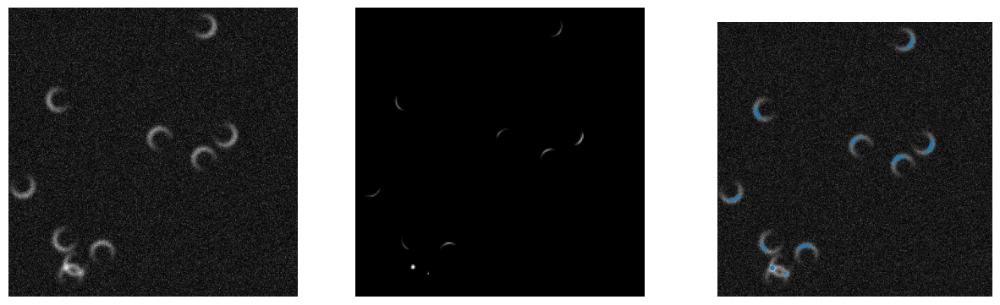

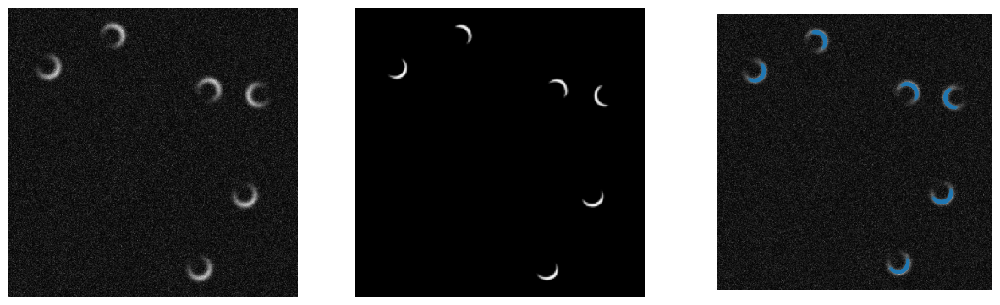

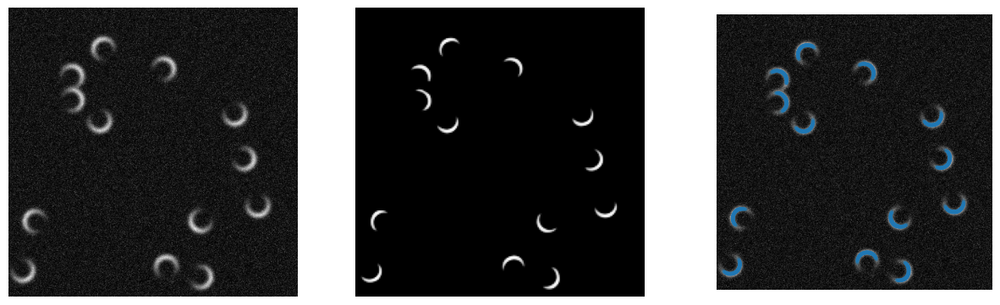

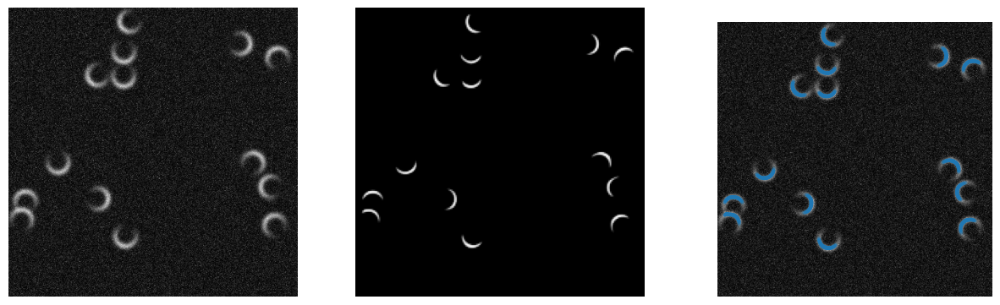

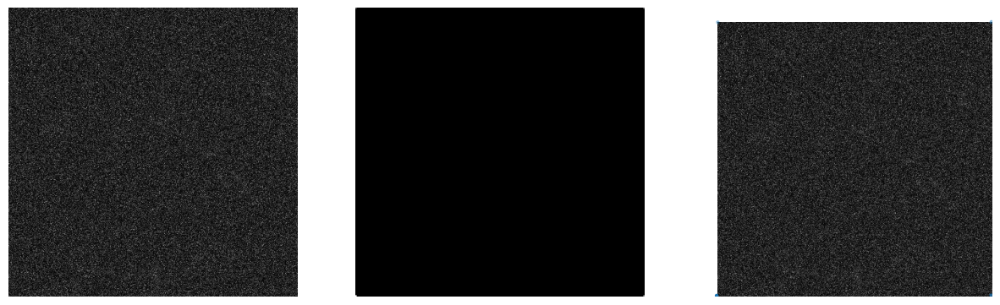

...

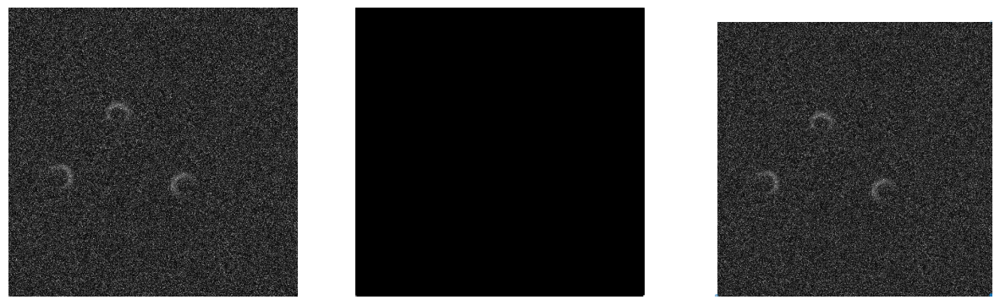

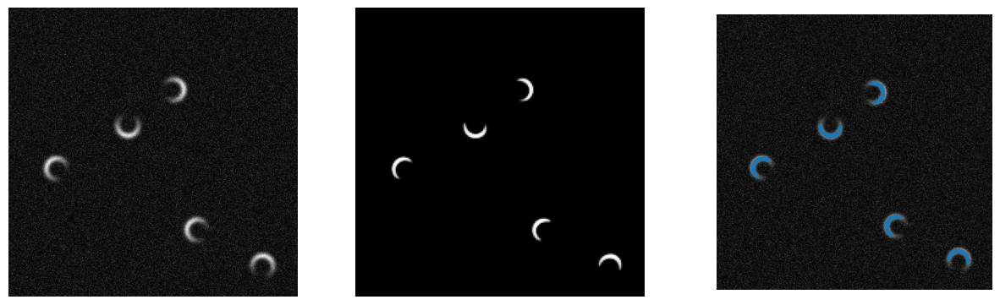

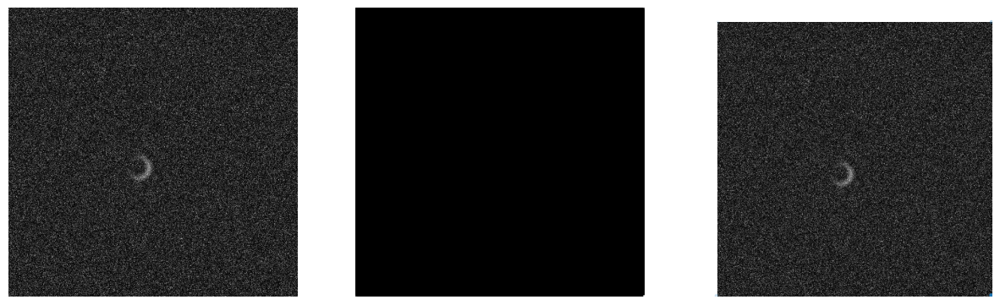

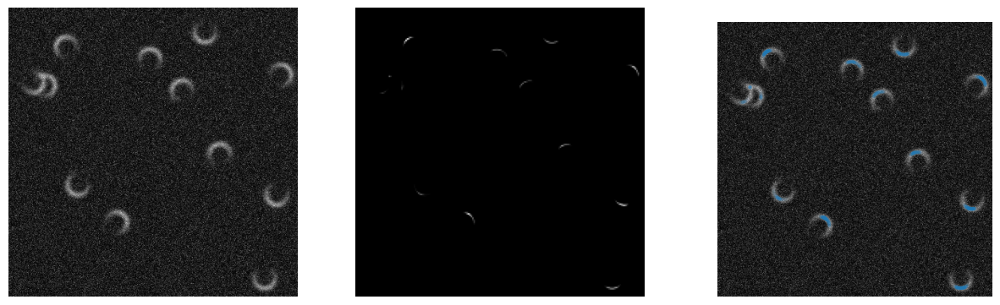

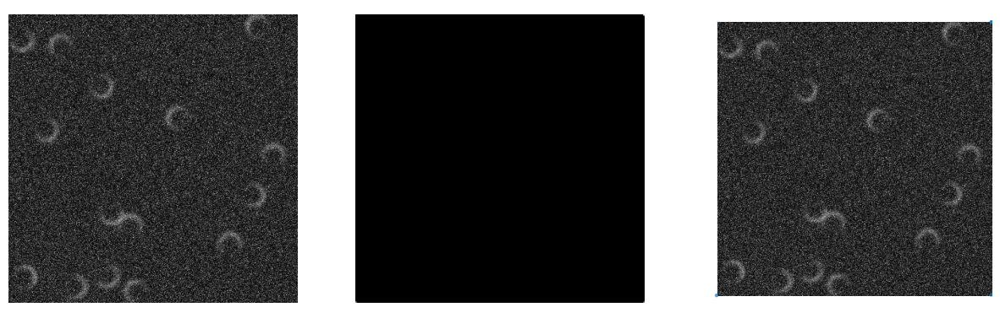

In [6]:
img_pred_list = []
for idx in range(len(data_list)):
    torch_image = torch.from_numpy(data_list[idx]).permute(2, 0, 1).unsqueeze(0).float()
    prediction = lodestar(torch_image)[0].detach().numpy()
    x, y, rho = prediction[0], prediction[1], prediction[-1]
    img_pred_list.append((x, y, rho))

    plt.figure(figsize=(15, 10))

    plt.subplot(1, 3, 1)
    plt.imshow(data_list[idx], cmap="gray")
    plt.axis("off")

    plt.subplot(1, 3, 2)
    plt.imshow(rho, cmap="gray")
    plt.axis("off")

    plt.subplot(1, 3, 3)
    plt.imshow(data_list[idx], cmap="gray")
    plt.scatter(y.flatten(), x.flatten(), alpha=rho.flatten() / rho.max(), s=5)
    plt.axis("off") 

    plt.show()